In [2]:
# Install libraries 
!pip install google-cloud-aiplatform
!pip install Pillow

In [43]:
# Authenticate (This should trigger oAuth to authenticate with end user's credentials using Appleconnect)
!gcloud auth application-default login

In [44]:
## To fill out by user
PROJECT_ID = '' # @param {type:"string"}

if PROJECT_ID == "":
    PROJECT_ID = input("Enter your value: ")
LOCATION = 'us-central1'  # @param {type:"string"}
print(f'Using project ID: {PROJECT_ID}')

Using project ID:  


In [26]:
# Import libraries 
import vertexai
import google.auth
from vertexai.language_models import TextGenerationModel


# Initialize Vertexai client
creds, _ = google.auth.default(quota_project_id=PROJECT_ID)
vertexai.init(project=PROJECT_ID, location=LOCATION, credentials=creds)



# Text generation model


In [9]:
# Create text generation model object from pre-trained text-bison 
model = TextGenerationModel.from_pretrained("text-bison")


In [10]:
# Text generation Sample 1

parameters = {
    "max_output_tokens": 2048,
    "temperature": 0.2,
    "top_p": 0.8,
    "top_k": 40
}

# Inference API call
response = model.predict(
    """Give me your review on the movie Interstellar
""",
    **parameters
)
print(f"Response from Model: {response.text}")

Response from Model:  Interstellar is a 2014 science fiction film directed by Christopher Nolan and starring Matthew McConaughey, Anne Hathaway, Jessica Chastain, and Michael Caine. The film tells the story of a group of astronauts who travel through a wormhole in space in search of a new home for humanity.

Interstellar is a visually stunning film with some truly breathtaking sequences. The film's score, by Hans Zimmer, is also excellent and helps to create a sense of awe and wonder. The cast is all excellent, with McConaughey giving a particularly strong performance as the film's protagonist, Cooper.

However, the film is not without its flaws. The pacing can be slow at times, and the film's ending is somewhat anticlimactic. Additionally, some of the film's scientific concepts are a bit too complex and may be difficult for some viewers to understand.

Overall, Interstellar is a well-made and thought-provoking film that is sure to stay with you long after you watch it. While it may no

In [48]:
# Text generation Sample 2

response = model.predict(
    """Write me advice on career planning including how I can make steps towards financial goals and getting a promotion
""",
    **parameters
)
print(f"Response from Model: {response.text}")



Response from Model:  1. **Set clear career goals.** What do you want to achieve in your career? Do you want to be a manager? Start your own business? Get a promotion? Once you know what you want, you can start to make a plan to achieve it.
2. **Identify your skills and strengths.** What are you good at? What do you enjoy doing? Your skills and strengths can help you narrow down your career options and find a job that you're passionate about.
3. **Do your research.** Learn as much as you can about the different career paths that are available to you. What are the job requirements? What's the salary range? What are the opportunities for advancement?
4. **Network with people in your field.** Attend industry events, connect with people on LinkedIn, and reach out to friends and family for referrals. Networking can help you learn about new opportunities and get your foot in the door.
5. **Get experience.** The best way to get a job is to have experience in the field. Look for internships, v

In [49]:
# Text generation Sample 3
response = model.predict(
    """"Give me ten interview questions for the role of program manager
""",
    **parameters
)
print(f"Response from Model: {response.text}")



Response from Model:  1. **What is your experience in managing programs?**
2. **What are your strengths and weaknesses as a program manager?**
3. **What is your approach to managing a program?**
4. **How do you handle risks and challenges in a program?**
5. **How do you communicate with stakeholders in a program?**
6. **How do you measure the success of a program?**
7. **What is your experience in working with cross-functional teams?**
8. **What is your experience in managing budgets and resources?**
9. **What is your experience in managing change in a program?**
10. **What are your career goals as a program manager?**


# Chat Model

In [50]:
from vertexai.language_models import ChatModel, InputOutputTextPair

# Create chat  model object from pre-trained chat-bison 
chat_model = ChatModel.from_pretrained("chat-bison@001")

# TODO developer - override these parameters as needed:
parameters = {
    "temperature": 0.2,  # Temperature controls the degree of randomness in token selection.
    "max_output_tokens": 256,  # Token limit determines the maximum amount of text output.
    "top_p": 0.95,  # Tokens are selected from most probable to least until the sum of their probabilities equals the top_p value.
    "top_k": 40,  # A top_k of 1 means the selected token is the most probable among all tokens.
}

# Start the model with basic context
chat = chat_model.start_chat(
    context="My name is Miles; an astronomer, knowledgeable about the solar system.",
    examples=[
        InputOutputTextPair(
            input_text="How many moons does Mars have?",
            output_text="The planet Mars has two moons, Phobos and Deimos.",
        ),
    ],
)





In [51]:
response = chat.send_message(
    "What is your name?", **parameters
)
print(f"Response from Model:\n{response.text}")

Response from Model:
My name is Miles; an astronomer, knowledgeable about the solar system.


In [52]:

response = chat.send_message(
    "How many planets are there in the solar system?", **parameters
)
print(f"Response from Model:\n{response.text}")

Response from Model:
There are eight planets in the solar system.


In [53]:
response = chat.send_message(
    "What happened with Pluto?", **parameters
)
print(f"Response from Model:\n{response.text}")

Response from Model:
Pluto was once considered to be the ninth planet in the solar system, but it was reclassified as a dwarf planet in 2006.


In [57]:
response = chat.send_message(
    "Why was it reclassified as a dwarf planet?", **parameters
)
print(f"Response from Model:\n{response.text}")

Response from Model:
The criteria for being a planet include:

* It must orbit the Sun.
* It must be large enough to be round.
* It must have cleared its orbit of other objects.

Pluto does not meet the third criterion because it has not cleared its orbit of other objects. There are many other objects in Pluto's orbit, such as the Kuiper Belt objects.


In [65]:
parameters = {
    "temperature": 0.3,  # Temperature controls the degree of randomness in token selection.
    "max_output_tokens": 1024,  # Token limit determines the maximum amount of text output.
    "top_p": 0.95,  # Tokens are selected from most probable to least until the sum of their probabilities equals the top_p value.
    "top_k": 40,  # A top_k of 1 means the selected token is the most probable among all tokens.
}

response = chat.send_message(
    "when were black holes, discovered, confirmed and identified?", **parameters
)
print(f"Response from Model:\n{response.text}")


Response from Model:
Black holes were first predicted by Albert Einstein in his general theory of relativity in 1915. The first direct evidence of a black hole was found in 1971. The first black hole to be directly observed was Cygnus X-1 in 1964. The first black hole to be photographed was M87 in 2019.


# Imagen model

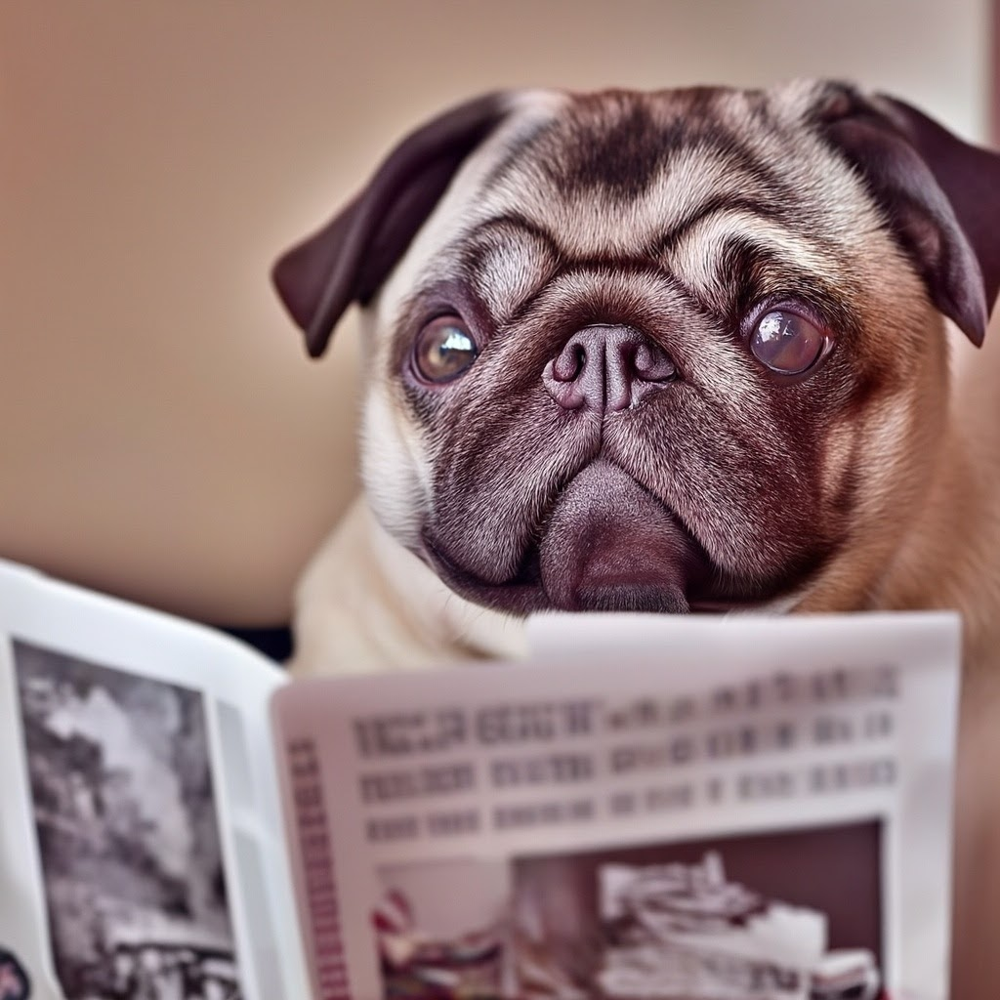

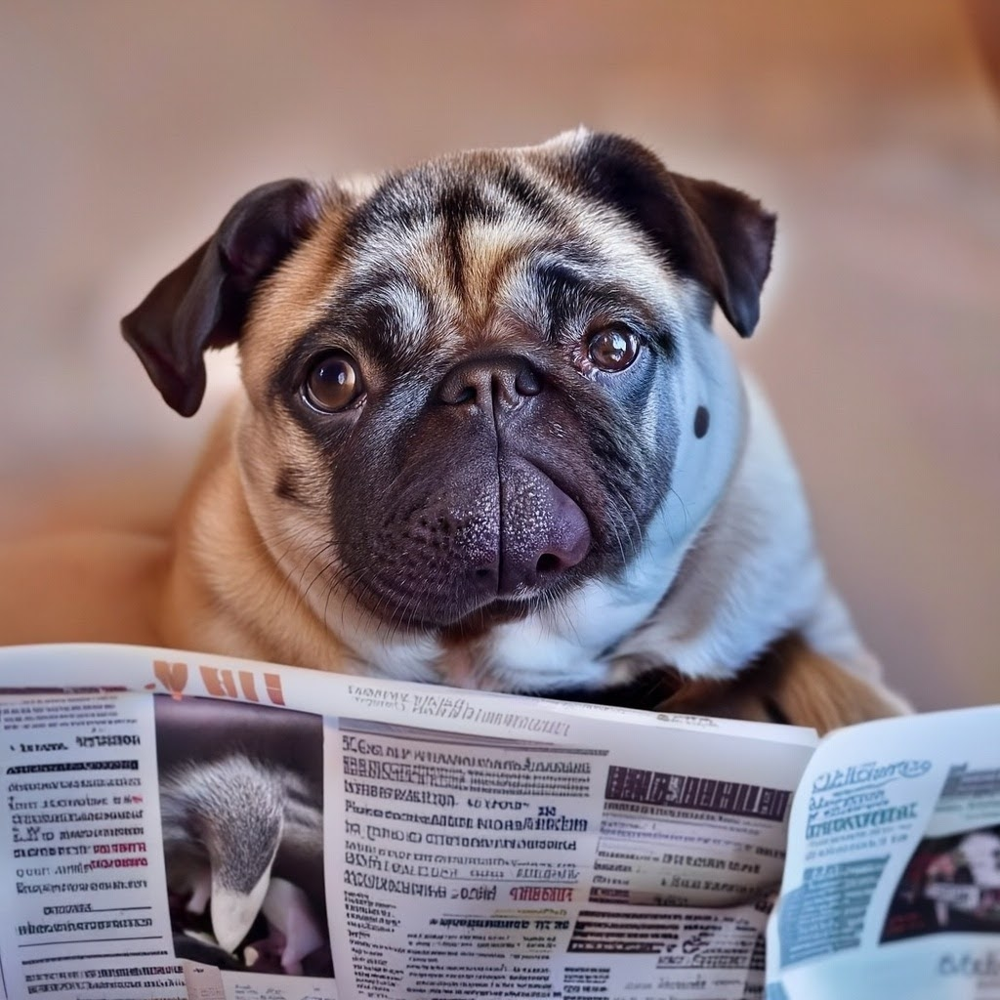

In [35]:
import vertexai
from vertexai.preview.vision_models import Image, ImageGenerationModel
from PIL import Image as PIL_Image

# These commands are a temporary requirement while the model is changing from private preview
from vertexai._model_garden import _model_garden_models
ImageGenerationModel._LAUNCH_STAGE = _model_garden_models._SDK_PRIVATE_PREVIEW_LAUNCH_STAGE


model = ImageGenerationModel.from_pretrained("imagegeneration@002")
images = model.generate_images(
  prompt="A pug reading the newspaper",
  # Optional:
  number_of_images=2,
  seed=1
)

images[0].save(location="./pug-gen-img1.png", include_generation_parameters=True)
images[1].save(location="./pug-gen-img2.png", include_generation_parameters=True)

# Optional. View the generated images in a notebook.
images[0].show()
images[1].show()

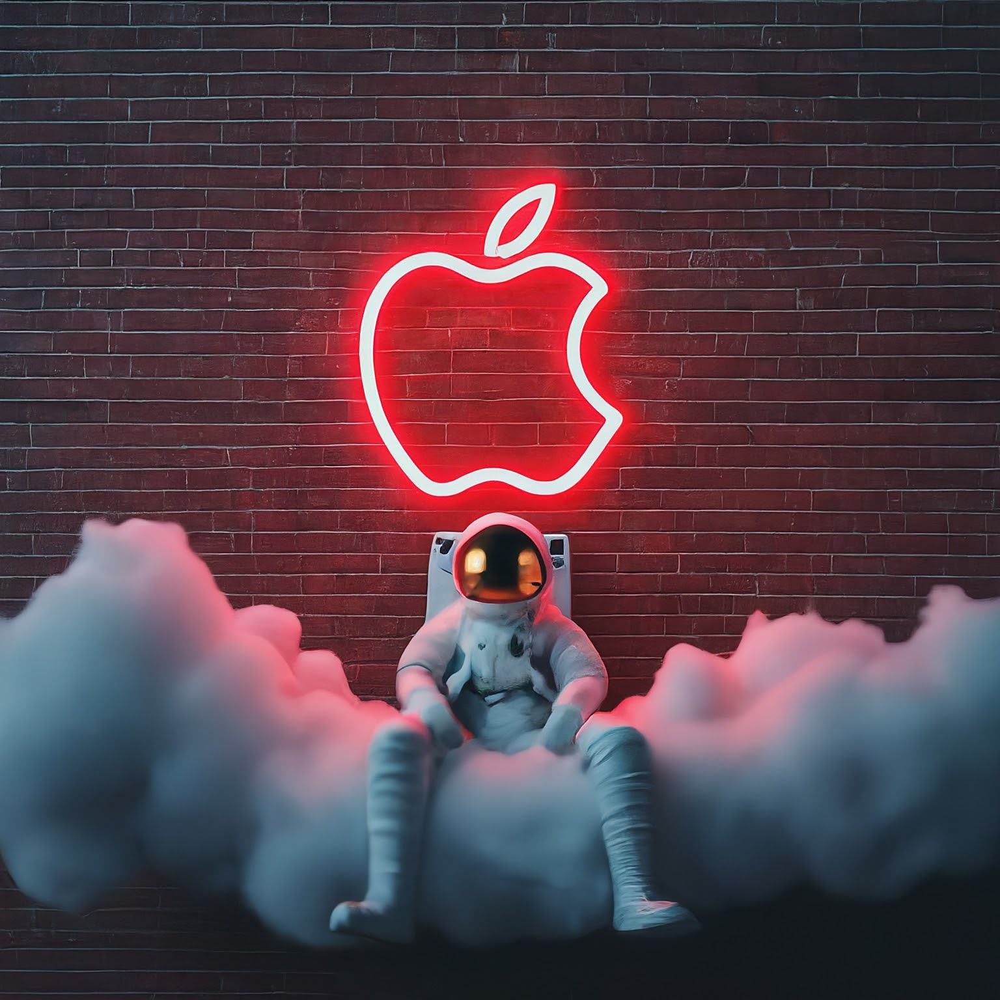

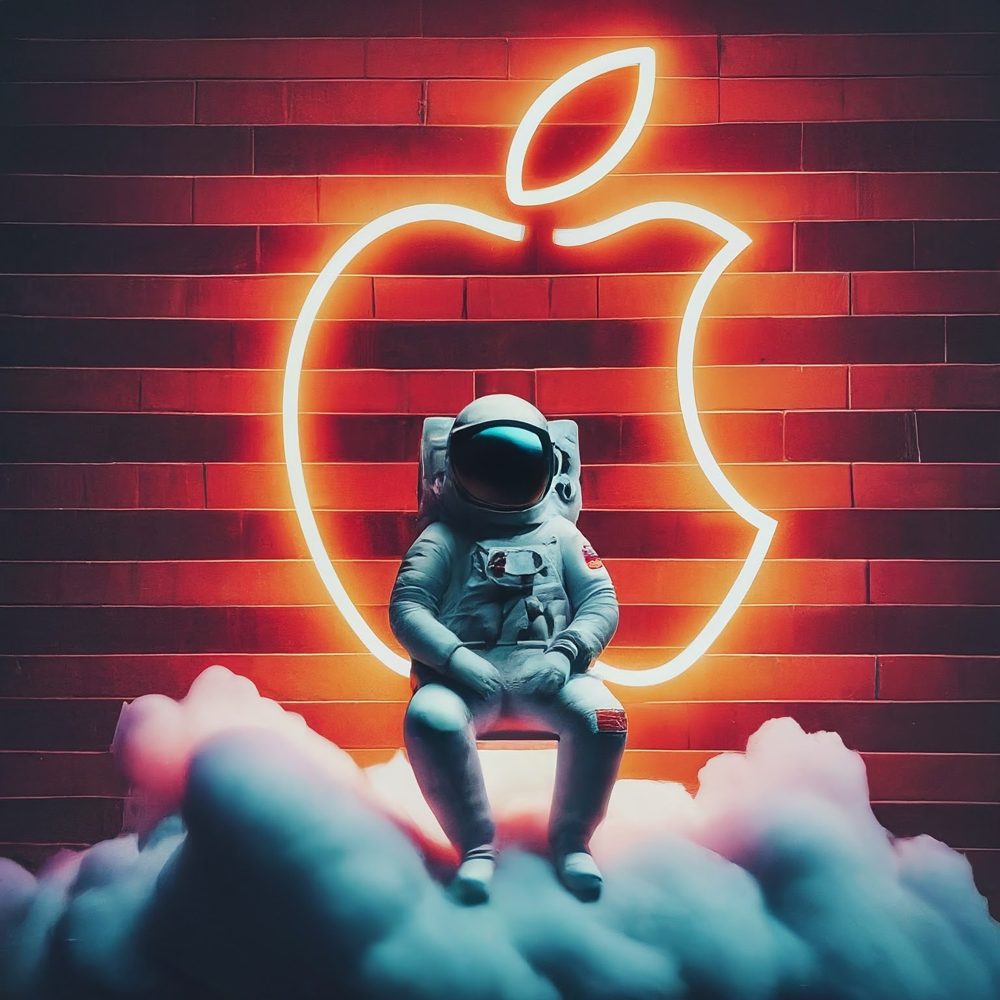

In [57]:
# Sample images bellow are built using Imagen version 004 which is still in preview (allow-listed only)

model = ImageGenerationModel.from_pretrained("imagegeneration@004")

images = model.generate_images(
  prompt="Apple logo in neon red on a brick wall with an astronaut in front sitting on a chair made of clouds, hyper realistic and stylized",
  # Optional:
  number_of_images=3,
    seed=1234
)

images[0].save(location="./astronaut-gen-img1.png", include_generation_parameters=True)
images[1].save(location="./astronaut-gen-img2.png", include_generation_parameters=True)
images[2].save(location="./astronaut-gen-img3.png", include_generation_parameters=True)


# Optional. View the generated images in a notebook.
images[0].show()
images[2].show()


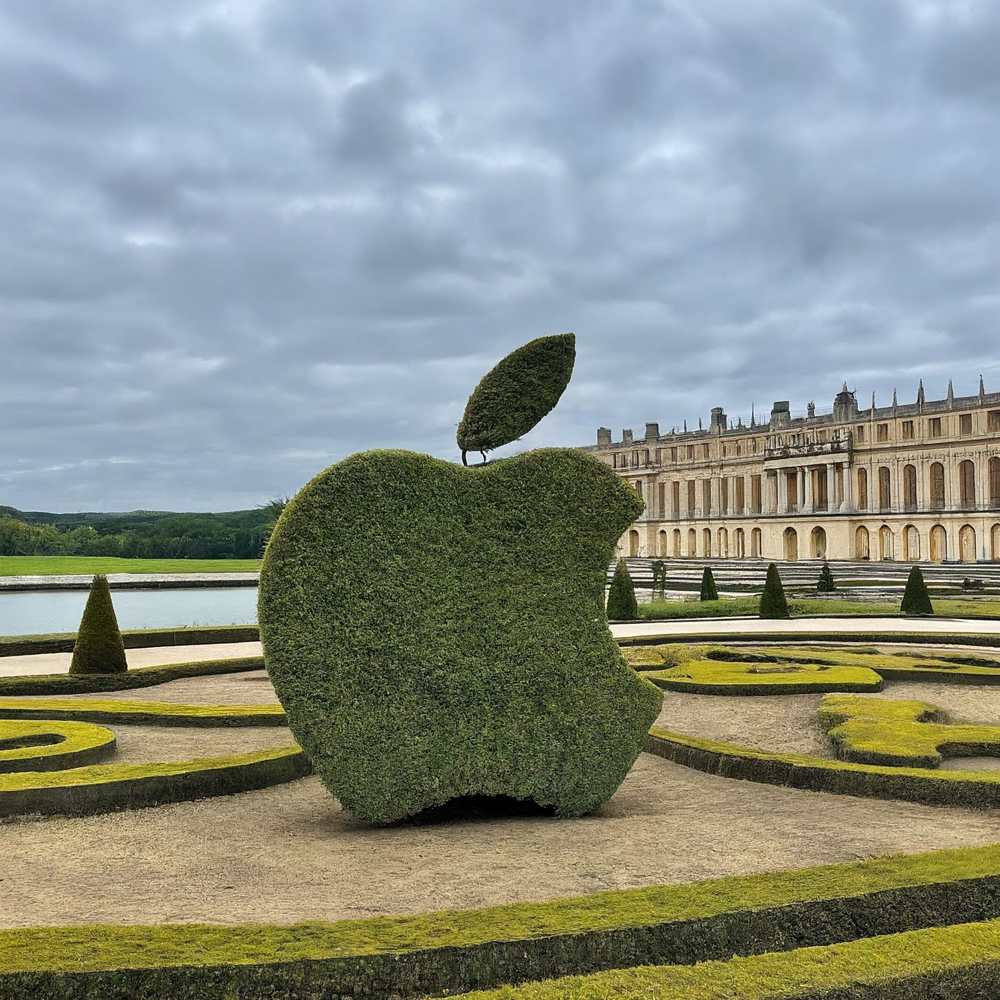

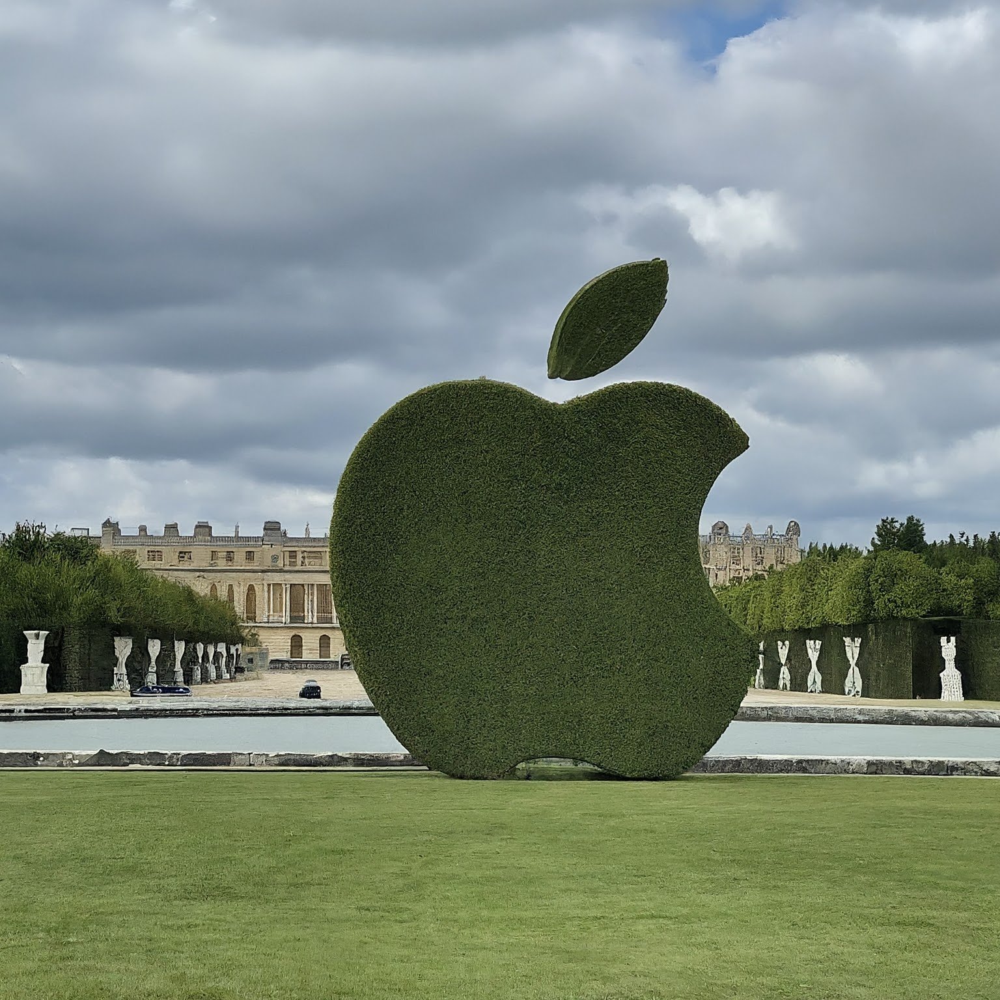

In [52]:
# Sample images bellow are built using Imagen version 004 which is still in preview (allow-listed only)

model = ImageGenerationModel.from_pretrained("imagegeneration@004")

images = model.generate_images(
  prompt="A topiary in the shape of the Apple logo with the Palace of Versailles in the background.",
  # Optional:
  number_of_images=2,
    seed=1234
)

images[0].save(location="./topiary-gen-img1.png", include_generation_parameters=True)
images[1].save(location="./topiary-gen-img2.png", include_generation_parameters=True)

# Optional. View the generated images in a notebook.
images[0].show()
images[1].show()



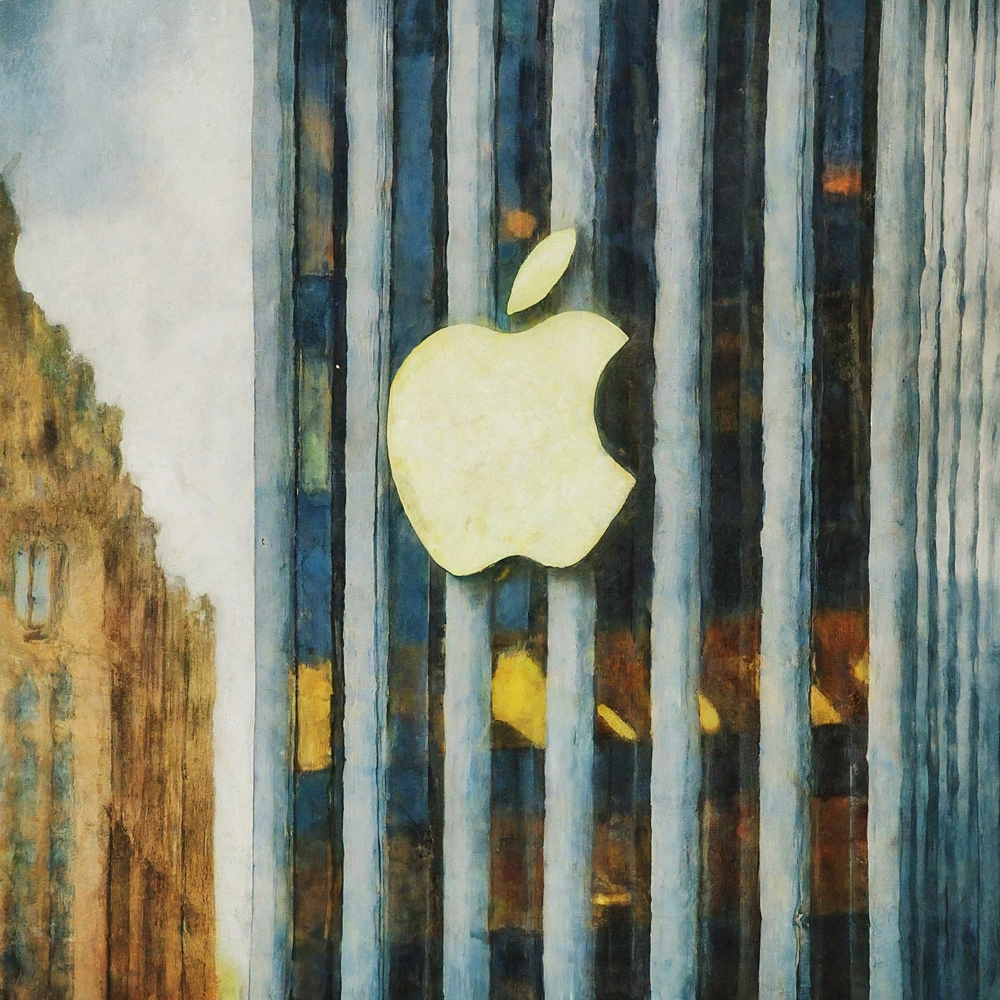

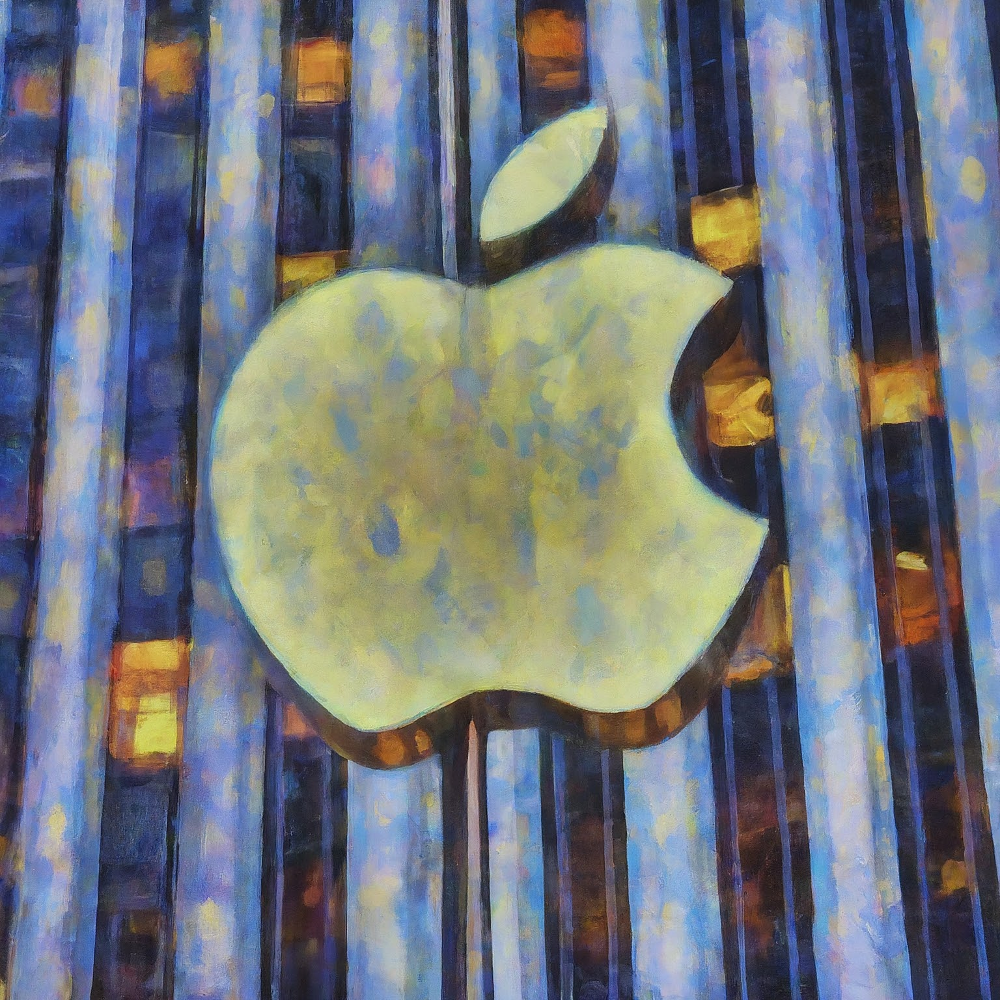

In [47]:
# Sample images bellow are built using Imagen version 004 which is still in preview (allow-listed only)

model = ImageGenerationModel.from_pretrained("imagegeneration@004")

images = model.generate_images(
  prompt="Apple logo on a skyscraper in the style of impressionist art",
  # Optional:
  number_of_images=3,
    seed=12
)

images[0].save(location="./art-gen-img1.png", include_generation_parameters=True)
images[1].save(location="./art-gen-img2.png", include_generation_parameters=True)


# Optional. View the generated images in a notebook.
images[0].show()
images[1].show()
